<a href="https://colab.research.google.com/github/yaolihua081/AIG_PC/blob/main/ROUGE_Evaluation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#This program contains Four parts:
1. Compute Rouge scores from all summaryies
2. Compute BertScores which compute similarities, from all summaries
3. Evaluate Rouge and bertScore using KullBack-L Divergence index, and Two-sample Kolmogorov-Smirnov  statistics and Pvalues
4. Plot the districutions for those F scores.

#the scores for the summary sentences can be compared with the scores for reference summaries, with the scores for the source sentences, or with the scores for other summarization systems. Rouge: It works by comparing an automatically produced summary or translation against a set of reference summaries (typically human-produced). 
Evalue all summary scores. Out put scores and plot the F scores

1.   Read in files with all summaries for each document
2.   produce scores for bettwen reference and hypotheis summary.
3.   output scores and plot them.



In [1]:
!pip install rouge
from rouge import Rouge 
rouge = Rouge()

In [ ]:
#from rouge import Rouge 

hypothesis = "the #### transcript is a written version of each day 's cnn student news program use this transcript to he    lp students with reading comprehension and vocabulary use the weekly newsquiz to test your knowledge of storie s you     saw on cnn student news"

reference = "this page includes the show transcript use the transcript to help students with reading comprehension and     vocabulary at the bottom of the page , comment for a chance to be mentioned on cnn student news . you must be a teac    her or a student age # # or older to request a mention on the cnn student news roll call . the weekly newsquiz tests     students ' knowledge of even ts in the news"

rouge = Rouge()
scores = rouge.get_scores(hypothesis, reference)
scores

[{'rouge-1': {'f': 0.4786324739396596,
   'p': 0.6363636363636364,
   'r': 0.3835616438356164},
  'rouge-2': {'f': 0.2608695605353498,
   'p': 0.3488372093023256,
   'r': 0.20833333333333334},
  'rouge-l': {'f': 0.44705881864636676,
   'p': 0.5277777777777778,
   'r': 0.3877551020408163}}]

In [4]:
#!pip install kaggle
from google.colab import files
files.upload()

Saving LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary_Rouge_eval.csv to LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary_Rouge_eval.csv


{'LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary_Rouge_eval.csv': b',metric,F_score,P_score,R_score,Methods,Document_No,Dominant_Topic,Topic_Perc_Contrib\n0,rouge-1,0.17647058434256063,0.12,0.3333333333333333,Bert-Gold,0,3.0,0.8223000168800354\n1,rouge-1,0.1791044736823347,0.12244897959183673,0.3333333333333333,Bert-Gold,1,4.0,0.40950000286102295\n2,rouge-1,0.20895521946981518,0.15555555555555556,0.3181818181818182,Bert-Gold,2,1.0,0.6643999814987183\n3,rouge-1,0.06451612416233128,0.07692307692307693,0.05555555555555555,Bert-Gold,3,3.0,0.6254000067710876\n4,rouge-1,0.09090908694214893,0.0625,0.16666666666666666,Bert-Gold,4,4.0,0.7044000029563904\n5,rouge-1,0.17721518649575393,0.11290322580645161,0.4117647058823529,Bert-Gold,5,0.0,0.8428000211715698\n6,rouge-1,0.23076922666420124,0.16216216216216217,0.4,Bert-Gold,6,2.0,0.5144000053405762\n7,rouge-1,0.28947367938019397,0.24444444444444444,0.3548387096774194,Bert-Gold,7,4.0,0.7749999761581421\n8,rouge-1,0.20689654677764577,0.1875,0.2

In [5]:
import re, numpy as np, pandas as pd
np.random.seed(400)
LDA_gensm_dominant_topics_modelLRG_5=pd.read_csv('LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary.csv')
LDA_gensm_dominant_topics_modelLRG_5.columns
LDA_gensm_dominant_topics_modelLRG_5['Gold_Summary']=LDA_gensm_dominant_topics_modelLRG_5['Question']+" "+LDA_gensm_dominant_topics_modelLRG_5['Answer']

FileNotFoundError: ignored

In [14]:
LDA_gensm_dominant_topics_modelLRG_5=LDA_gensm_dominant_topics_modelLRG_5.drop(labels=['Unnamed: 0','Unnamed: 0.1', 'Unnamed: 0.1.1'],axis=1)

In [16]:
def Remove_Extra(docfile):
  temp1 = docfile.replace("(<Sentence:", " ")
  temp2 = temp1.replace(">,)", " ")
  temp2 = temp1.replace(">,)", " ")
  ID_pattern=r'([T][O][\d]{1,2})'
  #ID_pattern="TO"
  #print(ID_pattern)
  temp3=re.findall(ID_pattern,temp2)
  if (len(temp3) > 0):
    temp2=temp2.replace(temp3[0],"")
  return temp2

columns=['Lsa_Passage_Sumy_Summary','Luhn_Passage_Sumy_Summary', 'LexRank_Passage_Sumy_Summary','TextRank_Passage_Sumy_Summary','Bert_Passage_Summary','GPT2_Passage_Summary',	'Bert_XLNet_Summary']

def Remove_Extra_Word(dat=LDA_gensm_dominant_topics_modelLRG_5):
  newdat=dat
  for name in columns:
    newdat[name]=dat[name].apply(lambda x: Remove_Extra(x)) 
  return newdat  

LDA_gensm_dominant_topics_modelLRG_5=Remove_Extra_Word(dat=LDA_gensm_dominant_topics_modelLRG_5)


In [ ]:
LDA_gensm_dominant_topics_modelLRG_5


In [ ]:
hypothesis=LDA_gensm_dominant_topics_modelLRG_5['Bert_Passage_Summary']
reference=LDA_gensm_dominant_topics_modelLRG_5['Gold_Summary']
rouge = Rouge()
#scores = rouge.get_scores(hypothesis, reference)

Bert_Score=rouge.get_scores(hypothesis[0], reference[0])
Bert_Score

[{'rouge-1': {'f': 0.17647058434256063, 'p': 0.12, 'r': 0.3333333333333333},
  'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0},
  'rouge-l': {'f': 0.10344827186682537,
   'p': 0.07142857142857142,
   'r': 0.1875}}]

In [ ]:
def Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_Passage_Summary',reference='Gold_Summary'):
  n=dat.shape[0]
  evalresult=pd.DataFrame()
  for i in range(n):
    #print(i)
    Bert_Score=rouge.get_scores(dat[hypothesis][i], dat[reference][i])
    for metric, results in sorted(Bert_Score[0].items()):
      if metric=='rouge-1':
        evalresult=evalresult.append(pd.Series([metric, results['f'],results['p'],results['r']]),ignore_index=True)
      
  evalresult.columns=['metric','F_score','P_score','R_score']
  evalresult['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
  evalresult['Document_No']=dat['Document_No']
  evalresult['Dominant_Topic']=dat['Dominant_Topic']
  evalresult['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']

  return evalresult


#
#pd.concat([Eval_Bert_Gold,LDA_gensm_dominant_topics_modelLRG_5],axis=1)

In [ ]:
Eval_Bert_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_Passage_Summary',reference='LexRank_Passage_Sumy_Summary')

Eval_Lsa_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Lsa_Passage_Sumy_Summary',reference='LexRank_Passage_Sumy_Summary')

Eval_Luhn_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Luhn_Passage_Sumy_Summary',reference='LexRank_Passage_Sumy_Summary')


Eval_Gold_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='LexRank_Passage_Sumy_Summary',reference='Gold_Summary')
Eval_Gold_Bert=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_Passage_Summary',reference='Gold_Summary')

Eval_Text_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='TextRank_Passage_Sumy_Summary',reference='LexRank_Passage_Sumy_Summary')




In [ ]:

Eval_GPT2_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='GPT2_Passage_Summary',reference='LexRank_Passage_Sumy_Summary')
Eval_XLNet_LexRank=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_XLNet_Summary',reference='LexRank_Passage_Sumy_Summary')

Eval_GPT2_Gold=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='GPT2_Passage_Summary',reference='Gold_Summary')
Eval_XLNet_Gold=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_XLNet_Summary',reference='Gold_Summary')


In [ ]:
Eval_XLNet_Bert=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='Bert_XLNet_Summary',reference='Bert_Passage_Summary')
Eval_GPT2_Bert=Results(dat=LDA_gensm_dominant_topics_modelLRG_5,hypothesis='GPT2_Passage_Summary',reference='Bert_Passage_Summary')

In [ ]:
Eval_XLNet_Bert['Methods']='XLNet-Bert'

In [ ]:
Eval_XLNet_Gold['Methods']='XLNet-Gold'

In [ ]:
all_eval=pd.concat([Eval_Bert_LexRank,Eval_Lsa_LexRank,Eval_Luhn_LexRank,Eval_Gold_LexRank,Eval_Gold_Bert,Eval_Text_LexRank,Eval_GPT2_LexRank,Eval_XLNet_LexRank,Eval_GPT2_Gold,Eval_XLNet_Gold],axis=0)

In [ ]:

all_eval=pd.concat([Eval_Gold_Bert,Eval_GPT2_Gold,Eval_XLNet_Gold,Eval_Gold_LexRank,Eval_Bert_LexRank,Eval_Lsa_LexRank,Eval_Luhn_LexRank,Eval_Text_LexRank,Eval_GPT2_LexRank,Eval_XLNet_LexRank],axis=0)
pd.DataFrame(all_eval).to_csv('LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary_Rouge_eval.csv')


In [ ]:
all_eval

In [ ]:
all_eval1=pd.concat([Eval_Bert_LexRank,Eval_Lsa_LexRank,Eval_Luhn_LexRank,Eval_Gold_LexRank,Eval_Gold_Bert,Eval_Text_LexRank],axis=0)

all_eval2=pd.concat([Eval_GPT2_LexRank,Eval_XLNet_LexRank,Eval_GPT2_Gold,Eval_XLNet_Gold,Eval_XLNet_Bert,Eval_GPT2_Bert],axis=0)

# Altair to plot

In [75]:
import altair as alt
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
Summary="Bert-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Recall scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('R_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Lsa_-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Recall scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('R_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()


Summary="Luhn-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Recall scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('R_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Text-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Recall scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('R_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1 & chart2
chart.save("Summary_Rscore1.html")
chart

alt.VConcatChart(...)

In [ ]:
Summary="Bert-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Precision scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Lsa_-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Precision scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()


Summary="Luhn-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Precision scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Text-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and Precision scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1 & chart2
chart.save("Summary_Pscore1.html")
chart

alt.VConcatChart(...)

In [ ]:
Summary="Bert-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Lsa_-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()


Summary="Luhn-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Text-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1 & chart2
chart.save("Summary_Fscore1.html")
chart

alt.VConcatChart(...)

In [ ]:
Summary="Bert-LexR"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="GPT2-LexR"
filter=all_eval2['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()


Summary="XLNet-Bert"
filter=all_eval2['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="GPT2-Bert"
filter=all_eval2['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1 & chart2
chart.save("Summary_Fscore2.html")
chart

alt.VConcatChart(...)

In [ ]:
Summary="LexR-Gold"
filter=all_eval1['Methods']==Summary
title="Topics and P scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Bert-Gold"
filter=all_eval1['Methods']==Summary
title="Topics and P scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="XLNet-Gold"
filter=all_eval2['Methods']==Summary
title="Topics and P scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="GPT2-Gold"
filter=all_eval2['Methods']==Summary
title="Topics and P scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('P_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()



chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1& chart2
chart.save("Gold_Pscore.html")
chart

alt.VConcatChart(...)

In [ ]:
Summary="LexR-Gold"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="Bert-Gold"
filter=all_eval1['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart2=alt.Chart(all_eval1[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="XLNet-Gold"
filter=all_eval2['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart3=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

Summary="GPT2-Gold"
filter=all_eval2['Methods']==Summary
title="Topics and F scores between "+str(Summary)+ " Summaries"
score_chart4=alt.Chart(all_eval2[filter],title=title).mark_bar().encode(
    alt.X('F_score:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()



chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart=chart1& chart2
chart.save("Gold_Fscore.html")
chart

alt.VConcatChart(...)

#We propose BERTScore, an automatic evaluation metric for text generation. Analogously to common metrics, BERTScore computes a similarity score for each token in the candidate sentence with each token in the reference sentence. However, instead of exact matches, we compute token similarity using contextual embeddings. We evaluate using the outputs of 363 machine translation and image captioning systems. BERTScore correlates better with human judgments and provides stronger model selection performance than existing metrics. Finally, we use an adversarial paraphrase detection task to show that BERTScore is more robust to challenging examples when compared to existing metrics.
#Full reference:
#BertScore computation is slow
Zhang, Tianyi, Varsha Kishore, Felix Wu, Kilian Q. Weinberger, and Yoav Artzi. "Bertscore: Evaluating text generation with bert." arXiv preprint arXiv:1904.09675 (2019).
#https://github.com/Tiiiger/bert_score/blob/master/example/Demo.ipynb

In [18]:

!pip install bert_score

     |████████████████████████████████| 61kB 3.0MB/s 
     |████████████████████████████████| 2.5MB 7.6MB/s 
     |████████████████████████████████| 901kB 29.8MB/s 
     |████████████████████████████████| 3.3MB 35.5MB/s 


In [ ]:
import bert_score
bert_score.__version__

'0.3.9'

In [ ]:
# hide the loading messages
import logging
import transformers
transformers.tokenization_utils.logger.setLevel(logging.ERROR)
transformers.configuration_utils.logger.setLevel(logging.ERROR)
transformers.modeling_utils.logger.setLevel(logging.ERROR)

In [73]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import rcParams

rcParams["xtick.major.size"] = 0
rcParams["xtick.minor.size"] = 0
rcParams["ytick.major.size"] = 0
rcParams["ytick.minor.size"] = 0

rcParams["axes.labelsize"] = "large"
rcParams["axes.axisbelow"] = True
rcParams["axes.grid"] = True

In [19]:
from bert_score import score

In [21]:
def BertScore(dat=LDA_gensm_dominant_topics_modelLRG_5, hypothesis='Bert_Passage_Summary',reference='Gold_Summary'):
  cands=LDA_gensm_dominant_topics_modelLRG_5[hypothesis].values.tolist()
  refs=LDA_gensm_dominant_topics_modelLRG_5[reference].values.tolist()
  #P, R, F1 = score(cands, refs, lang='en', rescale_with_baseline=True)
  P, R, F1 = score(cands, refs, lang='en')
  result=pd.concat([pd.DataFrame(P.tolist()),pd.DataFrame(R.tolist()),pd.DataFrame(F1.tolist())],axis=1)
  result.columns=["P","R","F"]
  #result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
  #result['Document_No']=dat['Document_No']
  #result['Dominant_Topic']=dat['Dominant_Topic']
  #result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
  return result

#result=BertScore(dat=LDA_gensm_dominant_topics_modelLRG_5, hypothesis='Bert_Passage_Summary',reference='Gold_Summary')
 

In [111]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Bert_Passage_Summary'
reference='Gold_Summary'
result=BertScore(dat=LDA_gensm_dominant_topics_modelLRG_5, hypothesis='Bert_Passage_Summary',reference='Gold_Summary')
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_Bert_Gold=result
pd.DataFrame(BertScore_Bert_Gold).to_csv('BertScore_Bert_Gold.csv')

Some weights of the model checkpoint at roberta-large were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [22]:
LDA_gensm_dominant_topics_modelLRG_5.columns

Index(['ID', 'Key', 'Passage', 'Question', 'Answer', 'Document_No',
       'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text',
       'Predicted_Topic_No', 'Type', 'Lsa_Passage_Sumy_Summary',
       'Luhn_Passage_Sumy_Summary', 'LexRank_Passage_Sumy_Summary',
       'TextRank_Passage_Sumy_Summary', 'Bert_Passage_Summary',
       'GPT2_Passage_Summary', 'Bert_XLNet_Summary', 'Gold_Summary'],
      dtype='object')

In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='LexRank_Passage_Sumy_Summary'
reference='Gold_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_LexRank_Gold=result
pd.DataFrame(BertScore_LexRank_Gold).to_csv('BertScore_LexRank_Gold.csv')

In [110]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Bert_XLNet_Summary'
reference='Gold_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']="XLNet"+"-"+str(reference[0:4])
BertScore_XLNet_Gold=result
pd.DataFrame(BertScore_XLNet_Gold).to_csv('BertScore_XLNet_Gold.csv')

Some weights of the model checkpoint at roberta-large were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='GPT2_Passage_Summary'
reference='Gold_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_GPT2_Gold=result
pd.DataFrame(BertScore_GPT2_Gold).to_csv('BertScore_GPT2_Gold.csv')

In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Luhn_Passage_Sumy_Summary'
reference='LexRank_Passage_Sumy_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_Luhn_LexR=result
pd.DataFrame(BertScore_Luhn_LexR).to_csv('BertScore_Luhn_LexR.csv')

In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Lsa_Passage_Sumy_Summary'
reference='LexRank_Passage_Sumy_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_Lsa_LexR=result
pd.DataFrame(BertScore_Lsa_LexR).to_csv('BertScore_Lsa_LexR.csv')

In [23]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='TextRank_Passage_Sumy_Summary'
reference='LexRank_Passage_Sumy_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_Text_LexR=result
pd.DataFrame(BertScore_Text_LexR).to_csv('BertScore_Text_LexR.csv')


Some weights of the model checkpoint at roberta-large were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Bert_XLNet_Summary'
reference='LexRank_Passage_Sumy_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_XLNet_LexR=result
pd.DataFrame(BertScore_XLNet_LexR).to_csv('BertScore_XLNet_LexR.csv')



In [25]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='GPT2_Passage_Summary'
reference='Bert_Passage_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_GPT2_Bert=result
pd.DataFrame(BertScore_GPT2_Bert).to_csv('BertScore_GPT2_Bert.csv')

Some weights of the model checkpoint at roberta-large were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
dat=LDA_gensm_dominant_topics_modelLRG_5
hypothesis='Bert_XLNet_Summary'
reference='Bert_Passage_Summary'
result=BertScore(dat, hypothesis,reference)
result['Document_No']=dat['Document_No']
result['Dominant_Topic']=dat['Dominant_Topic']
result['Topic_Perc_Contrib']=dat['Topic_Perc_Contrib']
result['Methods']=str(hypothesis[0:4])+"-"+str(reference[0:4])
BertScore_XLNet_Bert=result
pd.DataFrame(BertScore_XLNet_Bert).to_csv('BertScore_XLNet_Bert.csv')

In [ ]:
title="BertScore_Bert_Gold_F"
score_chart1=alt.Chart(BertScore_Bert_Gold,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
title="BertScore_GPT2_Gold_F"
score_chart2=alt.Chart(BertScore_GPT2_Gold,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
title="BertScore_XLNet_Gold_F"
score_chart3=alt.Chart(BertScore_XLNet_Gold,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
title="BertScore_LexR_Gold_F"
score_chart4=alt.Chart(BertScore_LexRank_Gold,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

title="BertScore_Luhn_LexR_F"
score_chart5=alt.Chart(BertScore_Luhn_LexR,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
title="BertScore_XLNet_LexR_F"
score_chart6=alt.Chart(BertScore_XLNet_LexR,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()

title="BertScore_Lsa_LexR_F"
score_chart7=alt.Chart(BertScore_Lsa_LexR,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
title="BertScore_XLNet_Bert_F"
score_chart8=alt.Chart(BertScore_XLNet_Bert,title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
chart1=score_chart1 | score_chart2
chart2=score_chart3 | score_chart4
chart_gold=chart1 & chart2
chart3=score_chart5 | score_chart6
chart4=score_chart7 | score_chart8
chart=chart3 & chart4

chart_gold.save("BertScore_Gold_F.html")
chart.save("BertScore_F.html")

In [114]:
BertScore_F=BertScore_F[BertScore_F.Methods !='Bert_Gold']


In [ ]:
all_eval1=pd.concat([BertScore_Lsa_LexR,BertScore_Luhn_LexR,BertScore_Bert_Gold,BertScore_GPT2_Gold,BertScore_XLNet_Gold, BertScore_LexRank_Gold,BertScore_XLNet_LexR,BertScore_XLNet_Bert],axis=0)
pd.DataFrame(all_eval1).to_csv('BertScore_F.csv')


In [47]:
pd.DataFrame(BertScore_F).to_csv('BertScore_F.csv')

In [ ]:
chart_gold

alt.VConcatChart(...)

In [ ]:
chart

alt.VConcatChart(...)

#How to measure the similarities between two summarization methods?

In [6]:
import re, numpy as np, pandas as pd
np.random.seed(400)

In [7]:
BertScore_F=pd.read_csv('BertScore_F.csv')
#BertScore_F=pd.read_csv('BertScore_Gold.csv')
Rouge_eval=pd.read_csv('LDA_gensm_dominant_topics_modelLRG_5_Stem_allSummary_Rouge_eval.csv')


In [8]:
BertScore_F=BertScore_F.drop(labels=['Unnamed: 0'],axis=1)
Rouge_eval=Rouge_eval.drop(labels=['Unnamed: 0'],axis=1)

In [9]:
filter=BertScore_F['Methods']=='Bert-Bert'
BertScore_F.loc[filter,'Methods']='XLNet-Bert'

In [117]:
pd.DataFrame(BertScore_F).to_csv('BertScore_F.csv')

#Define Kullback-Leibler Divergence. Kullback-Leibler divergence calculates a score that measures the divergence of one probability distribution from another.calculating the statistical distance between two statistical objects, e.g. probability distributions.
KL=sum{x} P(x) Log(P(x)/Q(x))

In [77]:
Summary="Bert-LexR"
filter=BertScore_F['Methods']==Summary
title="BertScore F between "+str(Summary)+ " Summaries"
score_chart1=alt.Chart(BertScore_F[filter],title=title).mark_bar().encode(
    alt.X('F:Q',bin=True),
    alt.Y('count():Q'),
    color='Dominant_Topic:Q'
#).interactive().to_html()
).interactive()
score_chart1



alt.Chart(...)

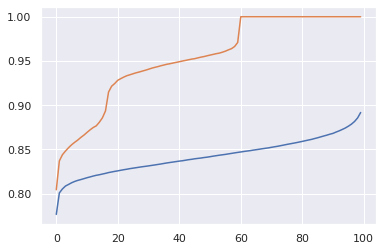

In [104]:
plt.plot(p)
plt.plot(q)

In [14]:
def kl_divergence(p, q):
    return np.sum(np.where(p != 0, p * np.log(p / q), 0))
method='Bert_Gold'
#define percentile distributions for F score  each methods

def Pct_BertScore(dat=BertScore_F, methods=method):
  Pct=np.empty(100)
  filter=dat['Methods']==methods
  for i in range(100):
    Pct[i]=np.percentile(dat[filter].F,i)
  return Pct

def Pct_Rouge(dat=Rouge_eval, methods=method):
  Pct=np.empty(100)
  filter=dat['Methods']==methods
  for i in range(100):
    Pct[i]=np.percentile(dat[filter].F_score,i)
  return Pct
#compute KL-divergence for two comparisons
def KLIndex(dat=BertScore_F, pair1='Bert-Gold',pair2='LexR-Gold'):
  result=0
  if (dat.equals(BertScore_F)):
    p=Pct_BertScore(dat,pair1)
    q=Pct_BertScore(dat,pair2)
    result=kl_divergence(p, q)
  elif (dat.equals(Rouge_eval)):
    p=Pct_Rouge(dat,pair1)
    q=Pct_Rouge(dat,pair2)
    result=kl_divergence(p, q)
  return result

def Eval_Pair_Matrix(dat=BertScore_F):
  pairs=set(dat['Methods'])
  pairs=list(pairs )
  df = pd.DataFrame(columns = pairs) 
  for i in range(len(pairs)):
    for j in range(len(pairs)):
      df.loc[i,pairs[j]]=KLIndex(dat, pairs[i],pairs[j])
  return df  




In [71]:
Rouge_F_KLDiv=Eval_Pair_Matrix(dat=Rouge_eval)
Rouge_F_KLDiv.index=Rouge_F_KLDiv.columns
pd.DataFrame(Rouge_F_KLDiv).to_csv('Rouge_F_KLDiv.csv')
Rouge_F_KLDiv

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in multiply
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


,LexR-Gold,Bert-Gold,Bert-LexR,XLNet-Gold,Text-LexR,GPT2-LexR,Lsa_-LexR,Luhn-LexR,GPT2-Gold
LexR-Gold,0,-1.21271,-21.1897,-1.03265,-18.4923,-21.2284,-17.2726,-20.0813,-1.23385
Bert-Gold,inf,0,-22.2442,0.255795,-18.7353,-22.3183,-17.3218,-20.5939,-0.00332415
Bert-LexR,inf,inf,0,inf,17.229,-0.311516,23.7519,8.55716,inf
XLNet-Gold,inf,-0.237601,-22.1027,0,-18.7333,-22.1719,-17.3633,-20.5394,-0.244872
Text-LexR,inf,inf,-4.45106,inf,0,-4.31574,6.65243,-3.90989,inf
GPT2-LexR,inf,inf,0.368888,inf,18.2585,0,24.7914,9.48022,inf
Lsa_-LexR,inf,inf,-7.48495,inf,-2.78364,-7.36286,0,-6.06064,inf
Luhn-LexR,inf,inf,0.796803,inf,10.3199,0.871069,18.1826,0,inf
GPT2-Gold,inf,0.00649959,-22.2329,0.258364,-18.773,-22.3054,-17.3741,-20.6118,0


In [69]:
BertScore_F_KLDiv=Eval_Pair_Matrix(dat=BertScore_F)
BertScore_F_KLDiv.index=BertScore_F_KLDiv.columns
pd.DataFrame(BertScore_F_KLDiv).to_csv('BertScore_F_KLDiv.csv')
BertScore_F_KLDiv

Index(['LexR-Gold', 'Bert-Gold', 'Bert-LexR', 'XLNet-Gold', 'Text-LexR',
       'Lsa_-LexR', 'XLNet-Bert', 'Luhn-LexR', 'GPT2-Gold', 'GPT2-Bert'],
      dtype='object')

In [109]:
method='Text-LexR'
def Pct_BertScore(dat=BertScore_F, methods=method):
  Pct=np.empty(100)
  filter=dat['Methods']==methods
  for i in range(100):
    Pct[i]=np.percentile(dat[filter].F,i)
  return Pct

p=Pct_BertScore(dat=BertScore_F, methods='Text-LexR')
q=Pct_BertScore(dat=BertScore_F, methods='Lsa_-LexR')

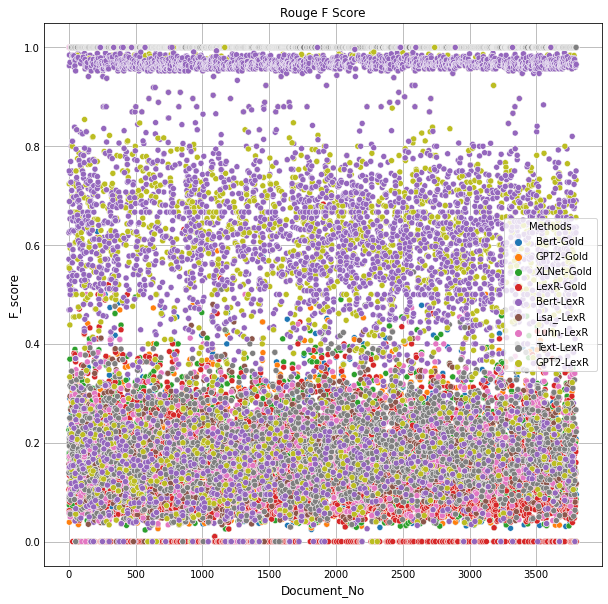

In [105]:
plt.figure(figsize=(10, 10))
filter=BertScore_F['Methods']=='Bert-Gold'
sns.scatterplot(x='Document_No', y='F_score', hue='Methods', data=Rouge_eval)
plt.title("Rouge F Score")
plt.show()

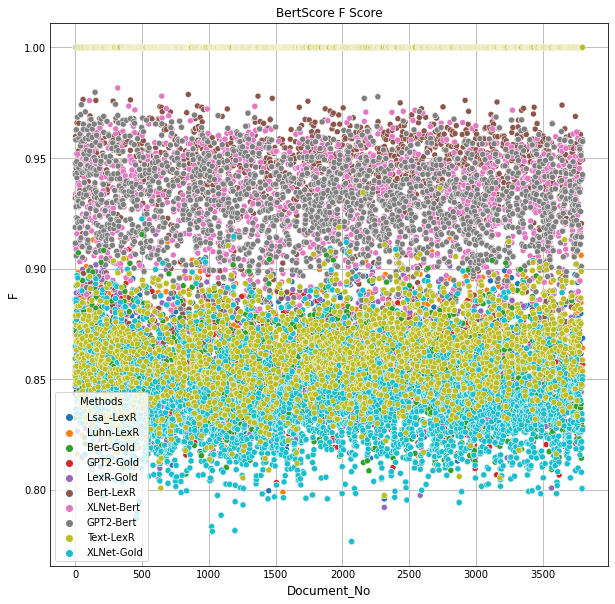

In [103]:
plt.figure(figsize=(10, 10))
filter=BertScore_F['Methods']=='Bert-Gold'
sns.scatterplot(x='Document_No', y='F', hue='Methods', data=BertScore_F)
plt.title("BertScore F Score")
plt.show()

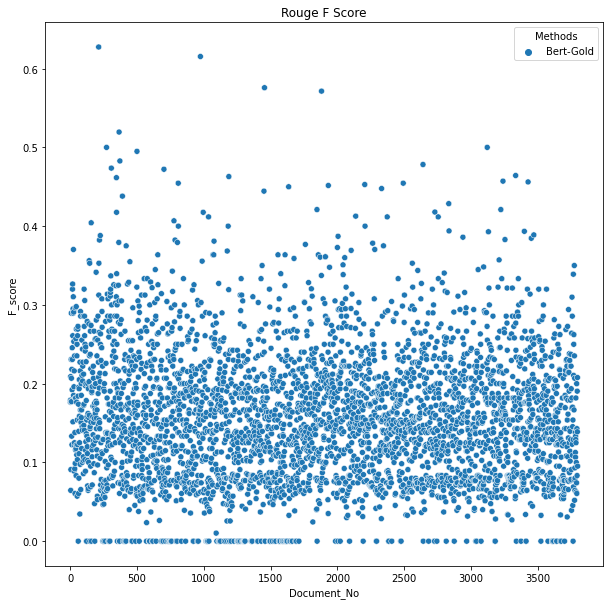

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10, 10))
filter=Rouge_eval['Methods']=='Bert-Gold'
sns.scatterplot(x='Document_No', y='F_score', hue='Methods', data=Rouge_eval[filter])
plt.title("Rouge F Score")
plt.show()

In [78]:
all_eval=Rouge_eval
grouped_df=all_eval.groupby("Methods")
mean_df = grouped_df.mean()
mean_Rouge=mean_df[['P_score','R_score','F_score']]
mean_Rouge.columns=['Mean_P','Mean_R','Mean_F']
median_df=grouped_df.median()
median_Rouge=median_df[['P_score','R_score','F_score']]
median_Rouge.columns=['Median_P','Median_R','Median_F']
max_df=grouped_df.max()
max_Rouge=max_df[['P_score','R_score','F_score']]
max_Rouge.columns=['Max_P','Max_R','Max_F']
min_df=grouped_df.min()
min_Rouge=min_df[['P_score','R_score','F_score']]
min_Rouge.columns=['Min_P','Min_R','Min_F']
rouge_summary=pd.concat([min_Rouge,mean_Rouge,median_Rouge,max_Rouge],axis=1)
rouge_summary
pd.DataFrame(rouge_summary).to_csv('Rouge_summary.csv')
rouge_summary

,Min_P,Min_R,Min_F,Mean_P,Mean_R,Mean_F,Median_P,Median_R,Median_F,Max_P,Max_R,Max_F
Methods,,,,,,,,,,,,
Bert-Gold,0.0,0.0,0.0,0.130313,0.237799,0.156235,0.120000,0.227273,0.149627,1.000000,0.842105,0.627451
Bert-LexR,0.0,0.0,0.0,0.614354,0.827147,0.673911,0.535299,0.933333,0.685714,1.000000,1.000000,1.000000
GPT2-Gold,0.0,0.0,0.0,0.131778,0.230904,0.156317,0.121951,0.214286,0.148148,1.000000,0.842105,0.642857
GPT2-LexR,0.0,0.0,0.0,0.614470,0.831620,0.677239,0.536585,0.933333,0.686795,1.000000,1.000000,1.000000
LexR-Gold,0.0,0.0,0.0,0.140945,0.155207,0.140976,0.125000,0.142857,0.133333,0.962963,0.736842,0.682927
Lsa_-LexR,0.0,0.0,0.0,0.519872,0.560134,0.531654,0.250000,0.348913,0.269231,1.000000,1.000000,1.000000
Luhn-LexR,0.0,0.0,0.0,0.640232,0.653922,0.641240,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Text-LexR,0.0,0.0,0.0,0.561754,0.610167,0.576276,0.310345,0.461538,0.333333,1.000000,1.000000,1.000000
XLNet-Gold,0.0,0.0,0.0,0.131431,0.222861,0.153582,0.119048,0.200000,0.145455,1.000000,0.857143,0.666667


In [79]:
all_eval1=BertScore_F
grouped_df = all_eval1.groupby("Methods")
mean_df = grouped_df.mean()
mean_BertScore=mean_df[['P','R','F']]
mean_BertScore.columns=['Mean_P','Mean_R','Mean_F']
median_df = grouped_df.median()
median_BertScore=median_df[['P','R','F']]
median_BertScore.columns=['Median_P','Median_R','Median_F']

mean_df = grouped_df.max()
max_BertScore=mean_df[['P','R','F']]
max_BertScore.columns=['Max_P','Max_R','Max_F']

mean_df = grouped_df.min()
min_BertScore=mean_df[['P','R','F']]
min_BertScore.columns=['Min_P','Min_R','Min_F']
BertScore_summary=pd.concat([min_BertScore,mean_BertScore,median_BertScore,max_BertScore],axis=1)

pd.DataFrame(BertScore_summary).to_csv('BertScore_summary.csv')
BertScore_summary

,Min_P,Min_R,Min_F,Mean_P,Mean_R,Mean_F,Median_P,Median_R,Median_F,Max_P,Max_R,Max_F
Methods,,,,,,,,,,,,
Bert-Gold,0.776096,0.749636,0.776619,0.836539,0.848989,0.842628,0.836116,0.847988,0.841756,0.975369,0.930761,0.922453
Bert-LexR,0.790303,0.792448,0.804479,0.938362,0.971640,0.954363,0.929285,0.987970,0.956656,1.000000,1.000000,1.000000
GPT2-Bert,0.820199,0.850233,0.858455,0.965285,0.962681,0.963806,0.990573,0.991613,0.967952,1.000000,1.000000,1.000000
GPT2-Gold,0.776096,0.749636,0.776619,0.837455,0.849367,0.843280,0.836738,0.848434,0.842320,0.975369,0.931692,0.922453
LexR-Gold,0.769336,0.749636,0.776619,0.844875,0.846175,0.845408,0.843846,0.844967,0.844840,0.977343,0.945549,0.946076
Lsa_-LexR,0.767740,0.780421,0.795898,0.915752,0.923224,0.919394,0.873420,0.889058,0.877976,1.000000,1.000000,1.000000
Luhn-LexR,0.783258,0.782419,0.797427,0.937944,0.940645,0.939227,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Text-LexR,0.767740,0.782419,0.797427,0.923416,0.931293,0.927261,0.885247,0.903877,0.891016,1.000000,1.000000,1.000000
XLNet-Bert,0.830549,0.835029,0.859484,0.964640,0.959165,0.961669,0.985367,0.981022,0.957371,1.000000,1.000000,1.000000


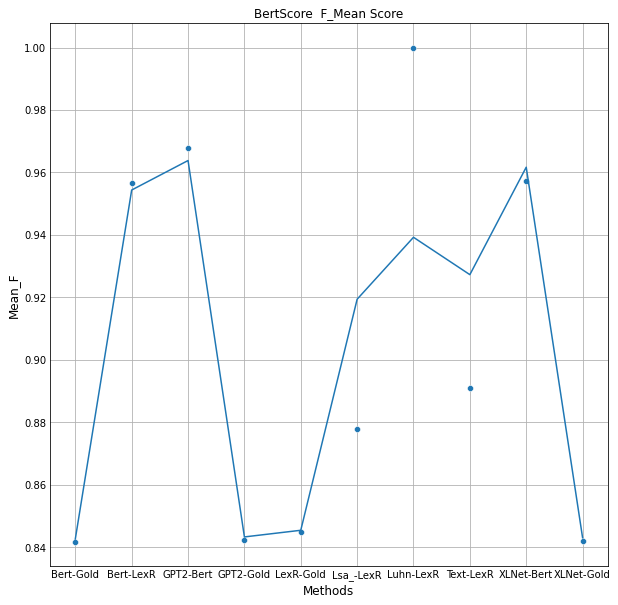

In [98]:
#import matplotlib.pyplot as plt
#import seaborn as sns
plt.figure(figsize=(10, 10))

sns.lineplot(x='Methods', y='Mean_F', data=BertScore_summary)
sns.scatterplot(x='Methods', y='Median_F', data=BertScore_summary)
plt.title("BertScore  F_Mean Score")
plt.show()

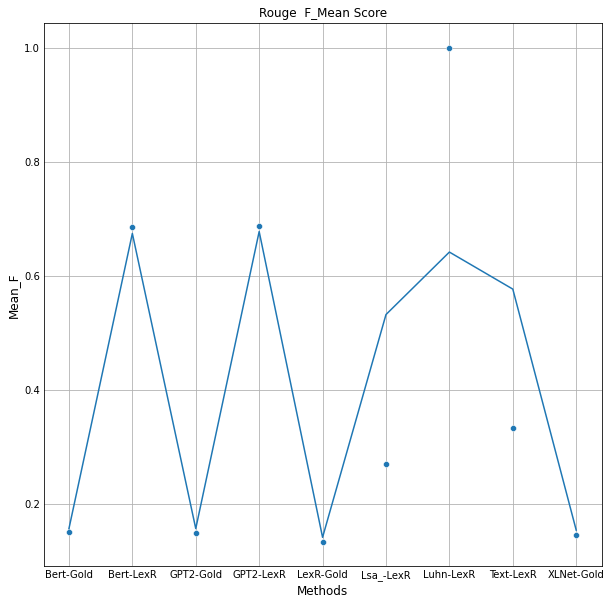

In [101]:
plt.figure(figsize=(10, 10))

sns.lineplot(x='Methods', y='Mean_F', data=rouge_summary)
sns.scatterplot(x='Methods', y='Median_F', data=rouge_summary)
plt.title("Rouge  F_Mean Score")
plt.show()

In [ ]:
print(f"System level F1 score: {F1.mean():.3f}")

In [90]:
BertScore_F

,P,R,F,Document_No,Dominant_Topic,Topic_Perc_Contrib,Methods
0,0.835286,0.851672,0.843400,0,3.0,0.8223,Lsa_-LexR
1,0.852314,0.849059,0.850683,1,4.0,0.4095,Lsa_-LexR
2,1.000000,1.000000,1.000000,2,1.0,0.6644,Lsa_-LexR
3,0.839962,0.867101,0.853316,3,3.0,0.6254,Lsa_-LexR
4,1.000000,1.000000,1.000000,4,4.0,0.7044,Lsa_-LexR
...,...,...,...,...,...,...,...
53195,1.000000,1.000000,1.000000,3795,2.0,0.5374,Text-LexR
53196,1.000000,1.000000,1.000000,3796,0.0,0.5591,Text-LexR
53197,0.856437,0.861024,0.858724,3797,4.0,0.4094,Text-LexR
53198,1.000000,1.000000,1.000000,3798,2.0,0.2903,Text-LexR


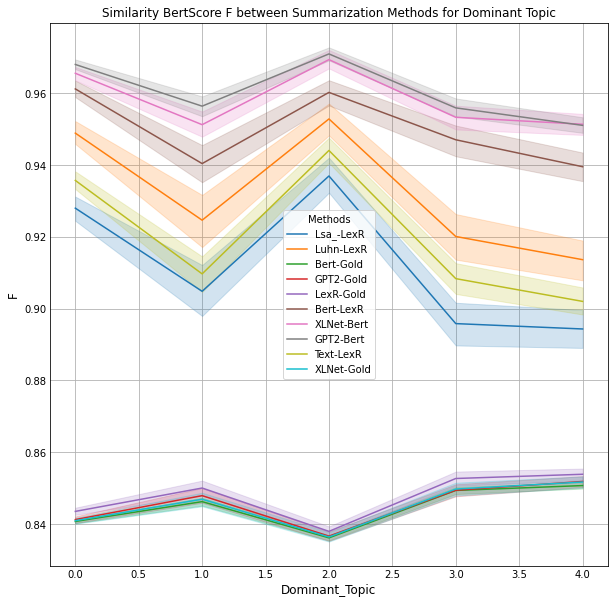

In [92]:
plt.figure(figsize=(10, 10))
sns.lineplot(x='Dominant_Topic',y='F', hue='Methods',data=BertScore_F)
plt.title("Similarity BertScore F between Summarization Methods for Dominant Topic")
plt.show()


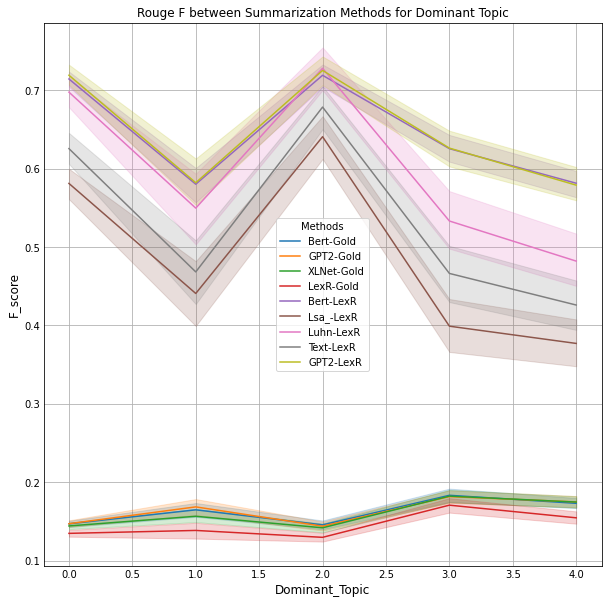

In [99]:
plt.figure(figsize=(10, 10))
sns.lineplot(x='Dominant_Topic',y='F_score', hue='Methods',data=Rouge_eval)
plt.title("Rouge F between Summarization Methods for Dominant Topic")
plt.show()

In [ ]:
title="Similarity BertScore F between Summarization Methods for Dominant Topic"
plt.figure(figsize=(10, 10))
score_chart=alt.Chart(BertScore_F, title=title).mark_bar().encode(
    alt.X('Dominant_Topic:Q',bin=True),
    alt.Y('F:Q'),
    color='Methods:Q'
#).interactive().to_html()
).interactive()
score_chart

#Perform a Kolmogorov-Smirnov Test 
#used to test whether or not or not a sample comes from a certain distribution.
#Kolmogorov-Smirnov test on these two samples to determine if they came from the same distribution:

In [10]:
from scipy.stats import ks_2samp

#perform Kolmogorov-Smirnov test
result=ks_2samp(p, q)
#If p-value is lower than a=0.05, then it is very probable that the two distributions are different.
#When statistic value is higher than the critical value, the two distributions are different.
#If the K-S statistic is small or the p-value is high, then we cannot reject the hypothesis that the distributions of the two samples are the same.
#KstestResult(statistic=0.99, pvalue=4.417521386399011e-57)
result.statistic,result.pvalue

NameError: ignored

In [11]:
def KSIndex(dat=BertScore_F, pair1='Bert-Gold',pair2='LexR-Gold'):
  result=[0,0]
  if (dat.equals(BertScore_F)):
    p=Pct_BertScore(dat,pair1)
    q=Pct_BertScore(dat,pair2)
    result=ks_2samp(p, q)
  elif (dat.equals(Rouge_eval)):
    p=Pct_Rouge(dat,pair1)
    q=Pct_Rouge(dat,pair2)
    result=ks_2samp(p, q)
  return [result.statistic,result.pvalue]

In [12]:
def KS_test(dat=BertScore_F):
  pairs=set(dat['Methods'])
  pairs=list(pairs )
  df1 = pd.DataFrame(columns = pairs) 
  df2 = pd.DataFrame(columns = pairs) 
  for i in range(len(pairs)):
    for j in range(len(pairs)):
      df1.loc[i,pairs[j]]=KSIndex(dat, pairs[i],pairs[j])[0]
      df2.loc[i,pairs[j]]=KSIndex(dat, pairs[i],pairs[j])[1]
  df1.index= pairs  
  df2.index= pairs 
  return df1,df2  


In [122]:
df1,df2=KS_test(dat=BertScore_F)

In [124]:
pd.DataFrame(df1).to_csv('BertScore_F_KS_statistic.csv')
pd.DataFrame(df2).to_csv('BertScore_F_KS_pvalue.csv')

In [15]:
df1,df2=KS_test(dat=Rouge_eval)

In [16]:
pd.DataFrame(df1).to_csv('Rouge_F_KS_statistic.csv')
pd.DataFrame(df2).to_csv('Rouge_F_KS_pvalue.csv')

In [17]:
df1

,Luhn-LexR,GPT2-Gold,XLNet-Gold,Text-LexR,LexR-Gold,GPT2-LexR,Bert-LexR,Lsa_-LexR,Bert-Gold
Luhn-LexR,0,0.56,0.56,0.09,0.56,0.55,0.55,0.14,0.56
GPT2-Gold,0.56,0,0.03,0.48,0.11,0.83,0.82,0.43,0.02
XLNet-Gold,0.56,0.03,0,0.48,0.1,0.83,0.82,0.43,0.03
Text-LexR,0.09,0.48,0.48,0,0.48,0.47,0.47,0.07,0.48
LexR-Gold,0.56,0.11,0.1,0.48,0,0.83,0.82,0.43,0.11
GPT2-LexR,0.55,0.83,0.83,0.47,0.83,0,0.03,0.42,0.83
Bert-LexR,0.55,0.82,0.82,0.47,0.82,0.03,0,0.42,0.82
Lsa_-LexR,0.14,0.43,0.43,0.07,0.43,0.42,0.42,0,0.43
Bert-Gold,0.56,0.02,0.03,0.48,0.11,0.83,0.82,0.43,0


In [ ]:
from bert_score import plot_example

In [ ]:
#plot_example(cands.values.tolist()[0], refs.values.tolist()[0], lang="en")
plot_example(cands.values.tolist()[0], refs.values.tolist()[0], lang="en",rescale_with_baseline=True)


In [ ]:
single_cands = ['I like lemons.']
multi_refs = [['I am proud of you.', 'I love lemons.', 'Go go go.']]

In [ ]:
plot_example(cands[0], refs[0], lang="en", rescale_with_baseline=True)

In [ ]:
P_mul, R_mul, F_mul = score(single_cands, multi_refs, lang="en", rescale_with_baseline=True)

In [ ]:
from bert_score import BERTScorer
scorer = BERTScorer(lang="en", rescale_with_baseline=True)
P, R, F1 = scorer.score(cands, refs)
scorer.plot_example(cands[0], refs[0])

In [ ]:
hyps='''
28-year-old chef found dead in San Francisco mall
A 28-year-old chef who recently moved to San Francisco was found dead in the staircase of a local shopping center.
The victim's brother said he cannot imagine anyone who would want to harm him,"Finally, it went uphill again at him."
The corpse, found Wednesday morning in the Westfield Mall, was identified as the 28-year-old Frank Galicia from San Francisco, the Justice Department said in San Francisco.
The San Francisco Police Department said the death was classified as murder and the investigation is on the running.
The victim's brother, Louis Galicia, told the ABS broadcaster KGO in San Francisco that Frank, who formerly worked as a cook in Boston, had his dream job as a cook at the Sons & Daughters restaurant in San Francisco six months ago.
A spokesman for the Sons & Daughters said they were "shocked and destroyed on the ground" over his death.
"We are a small team that works like a close family and we are going to miss him painfully," said the spokesman.
Our thoughts and condolences are in this difficult time at Franks's family and friends.
Louis Galicia admitted that Frank initially lived in hostels, but that "things for him finally went uphill." 
'''

refs='''28-Year-Old Chef Found Dead at San Francisco Mall
A 28-year-old chef who had recently moved to San Francisco was found dead in the stairwell of a local mall this week.
But the victim's brother says he can't think of anyone who would want to hurt him, saying, "Things were finally going well for him."
The body found at the Westfield Mall Wednesday morning was identified as 28-year-old San Francisco resident Frank Galicia, the San Francisco Medical Examiner's Office said.
The San Francisco Police Department said the death was ruled a homicide and an investigation is ongoing.
The victim's brother, Louis Galicia, told ABC station KGO in San Francisco that Frank, previously a line cook in Boston, had landed his dream job as line chef at San Francisco's Sons & Daughters restaurant six months ago.
A spokesperson for Sons & Daughters said they were "shocked and devastated" by his death.
"We are a small team that operates like a close knit family and he will be dearly missed," the spokesperson said.
Our thoughts and condolences are with Frank's family and friends at this difficult time.
Louis Galicia said Frank initially stayed in hostels, but recently, "Things were finally going well for him."
'''
